In [1]:
using Turing
using QuadGK
using StatsPlots
using DelimitedFiles
using StatsBase

ArgumentError: ArgumentError: Package StatsBase not found in current path.
- Run `import Pkg; Pkg.add("StatsBase")` to install the StatsBase package.

In [2]:
BAOm = [1512.39, 81.2087, 1975.22, 90.9029, 2306.68, 98.9647];

In [3]:
BAOcov = [624.707 23.729 325.332 8.34963 157.386 3.57778; 23.729 5.60873 11.6429 2.33996 6.39263 0.968056; 325.332 11.6429 905.777 29.3392 515.271 14.1013; 8.34963 2.33996 29.3392 5.42327 16.1422 2.85334; 157.386 6.39263 515.271 16.1422 1375.12 40.4327; 3.57778 0.968056 14.1013 2.85334 40.4327 6.25936];

In [4]:
@model function BAOmod(BAOmeas)
    Omegam ~ Uniform(0.2, 0.4)
    w ~ Uniform(-1.5, -0.5)
    z = 0.5
    DVmean = quadgk(x ->  3000/0.7/sqrt(Omegam*(1+x)^3 + (1.0 - Omegam)*(1+x)^(3*(w + 1.0))), 0, z)[1]
    Hmean = 70*sqrt(Omegam*(1+z)^3 + (1.0 - Omegam)*(1+z)^(3*(w + 1.0)))
    BAOmeas ~ MvNormal(BAOcov[3:4,3:4]) + [DVmean, Hmean]
end

BAOmod (generic function with 2 methods)

In [5]:
chain = sample(BAOmod(BAOm[3:4]), HMC(0.05, 10), 10000);

Sampling   0%|█                                         |  ETA: N/A


Sampling   0%|█                                         |  ETA: 0:24:24
Sampling   1%|█                                         |  ETA: 0:12:14
Sampling   2%|█                                         |  ETA: 0:08:07
Sampling   2%|█                                         |  ETA: 0:06:04
Sampling   2%|██                                        |  ETA: 0:04:50
Sampling   3%|██                                        |  ETA: 0:04:00
Sampling   4%|██                                        |  ETA: 0:03:25
Sampling   4%|██                                        |  ETA: 0:02:59
Sampling   4%|██                                        |  ETA: 0:02:38
Sampling   5%|███                                       |  ETA: 0:02:22


Sampling   6%|███                                       |  ETA: 0:02:08
Sampling   6%|███                                       |  ETA: 0:01:57
Sampling   6%|███                                       |  ETA: 0:01:48
Sampling   7%|███                                       |  ETA: 0:01:39
Sampling   8%|████                                      |  ETA: 0:01:32
Sampling   8%|████                                      |  ETA: 0:01:26
Sampling   8%|████                                      |  ETA: 0:01:21
Sampling   9%|████                                      |  ETA: 0:01:16
Sampling  10%|████                                      |  ETA: 0:01:12
Sampling  10%|█████                                     |  ETA: 0:01:08
Sampling  10%|█████                                     |  ETA: 0:01:04


Sampling  11%|█████                                     |  ETA: 0:01:01
Sampling  12%|█████                                     |  ETA: 0:00:58
Sampling  12%|██████                                    |  ETA: 0:00:56
Sampling  12%|██████                                    |  ETA: 0:00:53
Sampling  13%|██████                                    |  ETA: 0:00:51
Sampling  14%|██████                                    |  ETA: 0:00:49
Sampling  14%|██████                                    |  ETA: 0:00:47
Sampling  14%|███████                                   |  ETA: 0:00:45
Sampling  15%|███████                                   |  ETA: 0:00:43
Sampling  16%|███████                                   |  ETA: 0:00:42
Sampling  16%|███████                                   |  ETA: 0:00:40
Sampling  16%|███████                                   |  ETA: 0:00:39
Sampling  17%|████████                                  |  ETA: 0:00:37
Sampling  18%|████████                                  |  ETA: 


Sampling  20%|█████████                                 |  ETA: 0:00:32
Sampling  20%|█████████                                 |  ETA: 0:00:31
Sampling  20%|█████████                                 |  ETA: 0:00:30
Sampling  21%|█████████                                 |  ETA: 0:00:29
Sampling  22%|██████████                                |  ETA: 0:00:28
Sampling  22%|██████████                                |  ETA: 0:00:27
Sampling  22%|██████████                                |  ETA: 0:00:27
Sampling  23%|██████████                                |  ETA: 0:00:26
Sampling  24%|██████████                                |  ETA: 0:00:25
Sampling  24%|███████████                               |  ETA: 0:00:25
Sampling  24%|███████████                               |  ETA: 0:00:24


Sampling  25%|███████████                               |  ETA: 0:00:23
Sampling  26%|███████████                               |  ETA: 0:00:23
Sampling  26%|███████████                               |  ETA: 0:00:22
Sampling  26%|████████████                              |  ETA: 0:00:22
Sampling  27%|████████████                              |  ETA: 0:00:21
Sampling  28%|████████████                              |  ETA: 0:00:21
Sampling  28%|████████████                              |  ETA: 0:00:20
Sampling  28%|████████████                              |  ETA: 0:00:20
Sampling  29%|█████████████                             |  ETA: 0:00:19
Sampling  30%|█████████████                             |  ETA: 0:00:19
Sampling  30%|█████████████                             |  ETA: 0:00:18
Sampling  30%|█████████████                             |  ETA: 0:00:18
Sampling  31%|██████████████                            |  ETA: 0:00:17
Sampling  32%|██████████████                            |  ETA:

Sampling  33%|██████████████                            |  ETA: 0:00:16
Sampling  34%|███████████████                           |  ETA: 0:00:16
Sampling  34%|███████████████                           |  ETA: 0:00:15
Sampling  34%|███████████████                           |  ETA: 0:00:15
Sampling  35%|███████████████                           |  ETA: 0:00:15
Sampling  36%|███████████████                           |  ETA: 0:00:14
Sampling  36%|████████████████                          |  ETA: 0:00:14
Sampling  36%|████████████████                          |  ETA: 0:00:14
Sampling  37%|████████████████                          |  ETA: 0:00:14
Sampling  38%|████████████████                          |  ETA: 0:00:13
Sampling  38%|████████████████                          |  ETA: 0:00:13
Sampling  38%|█████████████████                         |  ETA: 0:00:13
Sampling  39%|█████████████████                         |  ETA: 0:00:12


Sampling  40%|█████████████████                         |  ETA: 0:00:12
Sampling  40%|█████████████████                         |  ETA: 0:00:12
Sampling  40%|██████████████████                        |  ETA: 0:00:12
Sampling  41%|██████████████████                        |  ETA: 0:00:12
Sampling  42%|██████████████████                        |  ETA: 0:00:11
Sampling  42%|██████████████████                        |  ETA: 0:00:11
Sampling  42%|██████████████████                        |  ETA: 0:00:11
Sampling  43%|███████████████████                       |  ETA: 0:00:11
Sampling  44%|███████████████████                       |  ETA: 0:00:10
Sampling  44%|███████████████████                       |  ETA: 0:00:10
Sampling  44%|███████████████████                       |  ETA: 0:00:10
Sampling  45%|███████████████████                       |  ETA: 0:00:10
Sampling  46%|████████████████████                      |  ETA: 0:00:10
Sampling  46%|████████████████████                      |  ETA:

Sampling  46%|████████████████████                      |  ETA: 0:00:09
Sampling  47%|████████████████████                      |  ETA: 0:00:09
Sampling  48%|████████████████████                      |  ETA: 0:00:09
Sampling  48%|█████████████████████                     |  ETA: 0:00:09
Sampling  48%|█████████████████████                     |  ETA: 0:00:09
Sampling  49%|█████████████████████                     |  ETA: 0:00:08
Sampling  50%|█████████████████████                     |  ETA: 0:00:08
Sampling  50%|██████████████████████                    |  ETA: 0:00:08
Sampling  50%|██████████████████████                    |  ETA: 0:00:08
Sampling  51%|██████████████████████                    |  ETA: 0:00:08
Sampling  52%|██████████████████████                    |  ETA: 0:00:08
Sampling  52%|██████████████████████                    |  ETA: 0:00:08
Sampling  52%|███████████████████████                   |  ETA: 0:00:07
Sampling  53%|███████████████████████                   |  ETA: 


Sampling  55%|████████████████████████                  |  ETA: 0:00:07
Sampling  56%|████████████████████████                  |  ETA: 0:00:07
Sampling  56%|████████████████████████                  |  ETA: 0:00:06
Sampling  56%|████████████████████████                  |  ETA: 0:00:06
Sampling  57%|████████████████████████                  |  ETA: 0:00:06
Sampling  57%|█████████████████████████                 |  ETA: 0:00:06
Sampling  58%|█████████████████████████                 |  ETA: 0:00:06
Sampling  58%|█████████████████████████                 |  ETA: 0:00:06
Sampling  59%|█████████████████████████                 |  ETA: 0:00:06
Sampling  60%|█████████████████████████                 |  ETA: 0:00:06
Sampling  60%|██████████████████████████                |  ETA: 0:00:06
Sampling  60%|██████████████████████████                |  ETA: 0:00:05
Sampling  61%|██████████████████████████                |  ETA: 0:00:05


Sampling  62%|██████████████████████████                |  ETA: 0:00:05
Sampling  62%|███████████████████████████               |  ETA: 0:00:05
Sampling  62%|███████████████████████████               |  ETA: 0:00:05
Sampling  63%|███████████████████████████               |  ETA: 0:00:05
Sampling  64%|███████████████████████████               |  ETA: 0:00:05
Sampling  64%|███████████████████████████               |  ETA: 0:00:05
Sampling  64%|████████████████████████████              |  ETA: 0:00:05
Sampling  65%|████████████████████████████              |  ETA: 0:00:04
Sampling  66%|████████████████████████████              |  ETA: 0:00:04
Sampling  66%|████████████████████████████              |  ETA: 0:00:04
Sampling  66%|████████████████████████████              |  ETA: 0:00:04
Sampling  67%|█████████████████████████████             |  ETA: 0:00:04
Sampling  68%|█████████████████████████████             |  ETA: 0:00:04
Sampling  68%|█████████████████████████████             |  ETA:


Sampling  70%|██████████████████████████████            |  ETA: 0:00:04
Sampling  70%|██████████████████████████████            |  ETA: 0:00:04
Sampling  71%|██████████████████████████████            |  ETA: 0:00:03
Sampling  72%|███████████████████████████████           |  ETA: 0:00:03
Sampling  72%|███████████████████████████████           |  ETA: 0:00:03
Sampling  72%|███████████████████████████████           |  ETA: 0:00:03
Sampling  73%|███████████████████████████████           |  ETA: 0:00:03
Sampling  74%|███████████████████████████████           |  ETA: 0:00:03
Sampling  74%|████████████████████████████████          |  ETA: 0:00:03
Sampling  74%|████████████████████████████████          |  ETA: 0:00:03
Sampling  75%|████████████████████████████████          |  ETA: 0:00:03
Sampling  76%|████████████████████████████████          |  ETA: 0:00:03
Sampling  76%|████████████████████████████████          |  ETA: 0:00:03
Sampling  76%|█████████████████████████████████         |  ETA:


Sampling  78%|█████████████████████████████████         |  ETA: 0:00:02
Sampling  79%|██████████████████████████████████        |  ETA: 0:00:02
Sampling  80%|██████████████████████████████████        |  ETA: 0:00:02
Sampling  80%|██████████████████████████████████        |  ETA: 0:00:02
Sampling  80%|██████████████████████████████████        |  ETA: 0:00:02
Sampling  81%|███████████████████████████████████       |  ETA: 0:00:02
Sampling  82%|███████████████████████████████████       |  ETA: 0:00:02
Sampling  82%|███████████████████████████████████       |  ETA: 0:00:02
Sampling  82%|███████████████████████████████████       |  ETA: 0:00:02
Sampling  83%|███████████████████████████████████       |  ETA: 0:00:02
Sampling  84%|████████████████████████████████████      |  ETA: 0:00:02
Sampling  84%|████████████████████████████████████      |  ETA: 0:00:02
Sampling  84%|████████████████████████████████████      |  ETA: 0:00:02


Sampling  85%|████████████████████████████████████      |  ETA: 0:00:02
Sampling  86%|████████████████████████████████████      |  ETA: 0:00:01
Sampling  86%|█████████████████████████████████████     |  ETA: 0:00:01
Sampling  86%|█████████████████████████████████████     |  ETA: 0:00:01
Sampling  87%|█████████████████████████████████████     |  ETA: 0:00:01
Sampling  88%|█████████████████████████████████████     |  ETA: 0:00:01
Sampling  88%|█████████████████████████████████████     |  ETA: 0:00:01
Sampling  88%|██████████████████████████████████████    |  ETA: 0:00:01
Sampling  89%|██████████████████████████████████████    |  ETA: 0:00:01
Sampling  90%|██████████████████████████████████████    |  ETA: 0:00:01
Sampling  90%|██████████████████████████████████████    |  ETA: 0:00:01
Sampling  90%|███████████████████████████████████████   |  ETA: 0:00:01
Sampling  91%|███████████████████████████████████████   |  ETA: 0:00:01
Sampling  92%|███████████████████████████████████████   |  ETA: 

Sampling  94%|████████████████████████████████████████  |  ETA: 0:00:01
Sampling  94%|████████████████████████████████████████  |  ETA: 0:00:01
Sampling  94%|████████████████████████████████████████  |  ETA: 0:00:01
Sampling  95%|████████████████████████████████████████  |  ETA: 0:00:00
Sampling  96%|█████████████████████████████████████████ |  ETA: 0:00:00
Sampling  96%|█████████████████████████████████████████ |  ETA: 0:00:00
Sampling  96%|█████████████████████████████████████████ |  ETA: 0:00:00
Sampling  97%|█████████████████████████████████████████ |  ETA: 0:00:00
Sampling  98%|█████████████████████████████████████████ |  ETA: 0:00:00
Sampling  98%|██████████████████████████████████████████|  ETA: 0:00:00
Sampling  98%|██████████████████████████████████████████|  ETA: 0:00:00
Sampling  99%|██████████████████████████████████████████|  ETA: 0:00:00
Sampling 100%|██████████████████████████████████████████|  ETA: 0:00:00
Sampling 100%|██████████████████████████████████████████| Time: 

Sampling 100%|██████████████████████████████████████████| Time: 0:00:09

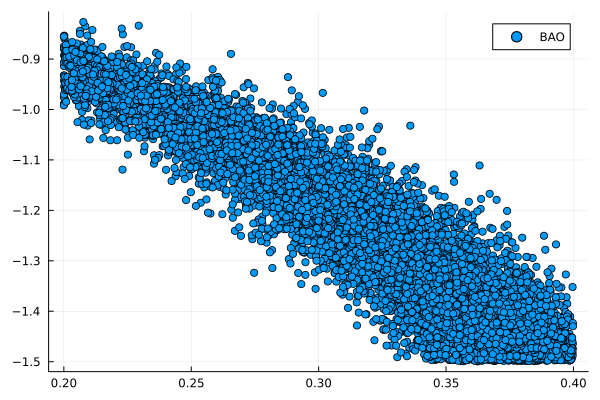

In [6]:
p = scatter(chain[:Omegam], chain[:w], label="BAO")

In [7]:
Ocpv = 0.1240/0.6597^2
Ocp = readdlm("kb_monopole/c102_k_b.txt")
Ocpk = mean(Ocp, dims=2)[1]
Ocmv = 0.1161/0.6736^2
Ocm = readdlm("kb_monopole/c103_k_b.txt")
Ocmk = mean(Ocm, dims=2)[1]
wpv = -0.9
wp = readdlm("kb_monopole/c108_k_b.txt")
wpk = mean(wp, dims=2)[1]
wmv = -1.1
wm = readdlm("kb_monopole/c109_k_b.txt")
wmk = mean(wm, dims=2)[1]

Occv = (Ocpv + Ocmv)/2
wcv = (wpv + wmv)/2
dOc = (Ocpk - Ocmk)/(Ocpv - Ocmv)
dw = (wpk - wmk)/(wpv - wmv)

-0.017017620993190433

In [8]:
kbossm

UndefVarError: UndefVarError: kbossm not defined

In [9]:
k = Vector()
w = Vector()
for file in readdir("chains_boss")
    if file[1:5] == "bossN" && file[end-2:end] == "txt"
        kb = readdlm(string("chains_boss/", file))
        append!(k, kb[:,3])
        append!(w, kb[:,1])
    end
end


In [10]:
kbossm = sum(k.*w)./sum(w)
kbosss = sqrt.(sum((k .- kbossm).^2 .*w)./sum(w))

0.0012752900271350248

In [11]:
@model function kmod(kmeas)
    Omegam ~ Uniform(0.2, 0.4)
    w ~ Uniform(-1.5, -0.5)
    kmeas ~ Normal((Omegam - Occv)*dOc + (w - wcv)*dw, kbosss)
end

kmod (generic function with 2 methods)

In [12]:
chain = sample(kmod(kbossm), HMC(0.05, 10), 10000);

Sampling   0%|█                                         |  ETA: N/A


Sampling   0%|█                                         |  ETA: 0:02:30
Sampling   1%|█                                         |  ETA: 0:01:15
Sampling   2%|█                                         |  ETA: 0:00:50
Sampling   2%|█                                         |  ETA: 0:00:37
Sampling   2%|██                                        |  ETA: 0:00:30
Sampling   3%|██                                        |  ETA: 0:00:25
Sampling   4%|██                                        |  ETA: 0:00:21
Sampling   4%|██                                        |  ETA: 0:00:18
Sampling   4%|██                                        |  ETA: 0:00:16
Sampling   5%|███                                       |  ETA: 0:00:15
Sampling   6%|███                                       |  ETA: 0:00:13
Sampling   6%|███                                       |  ETA: 0:00:12
Sampling   6%|███                                       |  ETA: 0:00:11
Sampling   7%|███                                       |  ETA:

Sampling  40%|█████████████████                         |  ETA: 0:00:01
Sampling  40%|█████████████████                         |  ETA: 0:00:01
Sampling  40%|██████████████████                        |  ETA: 0:00:01
Sampling  41%|██████████████████                        |  ETA: 0:00:01
Sampling  42%|██████████████████                        |  ETA: 0:00:01
Sampling  42%|██████████████████                        |  ETA: 0:00:01
Sampling  42%|██████████████████                        |  ETA: 0:00:01
Sampling  43%|███████████████████                       |  ETA: 0:00:01
Sampling  44%|███████████████████                       |  ETA: 0:00:01
Sampling  44%|███████████████████                       |  ETA: 0:00:01
Sampling  44%|███████████████████                       |  ETA: 0:00:01
Sampling  45%|███████████████████                       |  ETA: 0:00:01
Sampling  46%|████████████████████                      |  ETA: 0:00:01
Sampling  46%|████████████████████                      |  ETA: 

Sampling  63%|███████████████████████████               |  ETA: 0:00:01
Sampling  64%|███████████████████████████               |  ETA: 0:00:01
Sampling  64%|███████████████████████████               |  ETA: 0:00:01
Sampling  64%|████████████████████████████              |  ETA: 0:00:01
Sampling  65%|████████████████████████████              |  ETA: 0:00:01
Sampling  66%|████████████████████████████              |  ETA: 0:00:01
Sampling  66%|████████████████████████████              |  ETA: 0:00:00
Sampling  66%|████████████████████████████              |  ETA: 0:00:00
Sampling  67%|█████████████████████████████             |  ETA: 0:00:00
Sampling  68%|█████████████████████████████             |  ETA: 0:00:00
Sampling  68%|█████████████████████████████             |  ETA: 0:00:00
Sampling  68%|█████████████████████████████             |  ETA: 0:00:00
Sampling  69%|█████████████████████████████             |  ETA: 0:00:00
Sampling  70%|██████████████████████████████            |  ETA: 

Sampling  98%|█████████████████████████████████████████ |  ETA: 0:00:00
Sampling  98%|██████████████████████████████████████████|  ETA: 0:00:00
Sampling  98%|██████████████████████████████████████████|  ETA: 0:00:00
Sampling  99%|██████████████████████████████████████████|  ETA: 0:00:00
Sampling 100%|██████████████████████████████████████████|  ETA: 0:00:00
Sampling 100%|██████████████████████████████████████████| Time: 0:00:01
Sampling 100%|██████████████████████████████████████████| Time: 0:00:01


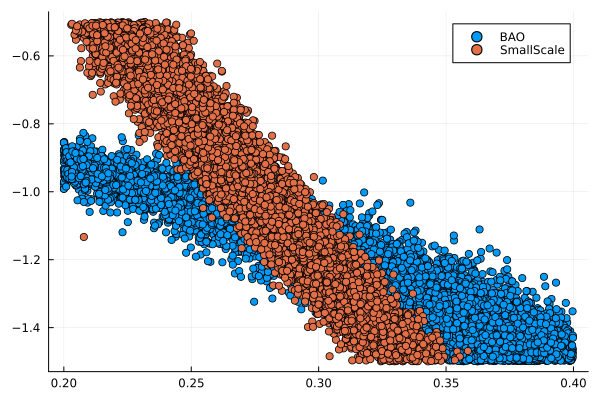

In [13]:
p = scatter!(chain[:Omegam], chain[:w], label="SmallScale")

In [163]:
@model function combined_mod(kmeas, BAOmeas)
    Omegam ~ Uniform(0.2, 0.4)
    w ~ Uniform(-1.5, -0.5)
    kmeas ~ Normal((Omegam - Occv)*dOc + (w - wcv)*dw, kbosss)
    z = 0.5
    DVmean = quadgk(x ->  3000/0.7/sqrt(Omegam*(1+x)^3 + (1.0 - Omegam)*(1+x)^(3*(w + 1.0))), 0, z)[1]
    Hmean = 70*sqrt(Omegam*(1+z)^3 + (1.0 - Omegam)*(1+z)^(3*(w + 1.0)))
    BAOmeas ~ MvNormal(BAOcov[3:4,3:4]) + [DVmean, Hmean]
end

combined_mod (generic function with 2 methods)

In [14]:
chain = sample(combined_mod(kbossm, BAOm[3:4]), HMC(0.05, 10), 10000);

UndefVarError: UndefVarError: combined_mod not defined

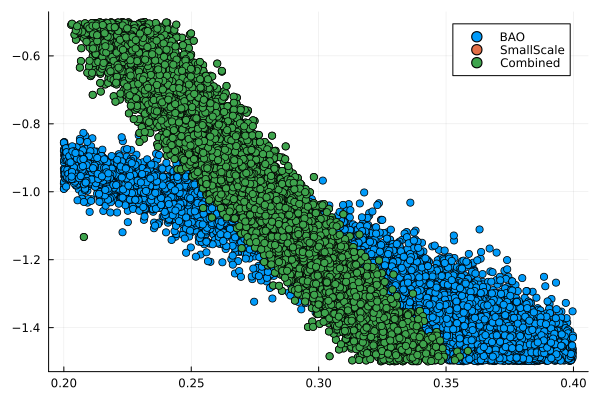

In [15]:
p = scatter!(chain[:Omegam], chain[:w], label="Combined")

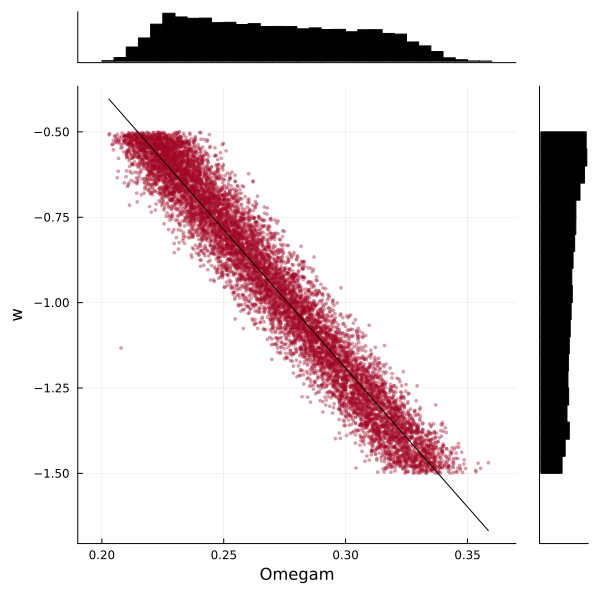

In [16]:
corner(chain)

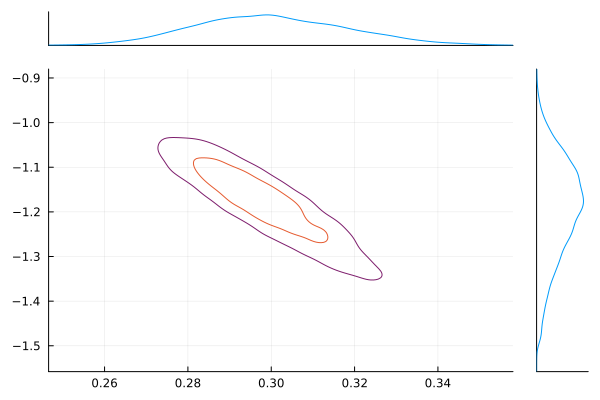

In [172]:
marginalkde(chain[:Omegam], chain[:w], levels=3)